## Imports & Stuff

In [1]:
import pandas as pd
## pandas 1.1.1 necessary
import numpy as np
import string 
import re
from sklearn.feature_extraction.text import TfidfVectorizer
import math
from gensim.models import Word2Vec
from plotly.graph_objects import Scatter3d
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import WhitespaceTokenizer
from nltk.corpus import stopwords 

In [2]:
! pwd

/c/Users/psmag/code/simonjpastor/delphes/notebooks/simonjpastor_notebooks


In [3]:
data = pd.read_pickle('../../delphes/data/extended_tweet_df')
data

,mep_id,name,country,group,nat_group,twitter,content
0,197490,Magdalena ADAMOWICZ,Poland,Group of the European People's Party (Christia...,Independent,Adamowicz_Magda,@danutahuebner Bardzo dziękuję @danutahuebner👍...
1,197490,Magdalena ADAMOWICZ,Poland,Group of the European People's Party (Christia...,Independent,Adamowicz_Magda,Komisja @EP_Justice przyjęła 3 arcyważne proje...
2,197490,Magdalena ADAMOWICZ,Poland,Group of the European People's Party (Christia...,Independent,Adamowicz_Magda,Komisja @EP_Justice przyjęła 3 projekty pilota...
3,197490,Magdalena ADAMOWICZ,Poland,Group of the European People's Party (Christia...,Independent,Adamowicz_Magda,"W tym dniu, w tym miejscu, w tej godzinie pros..."
4,197490,Magdalena ADAMOWICZ,Poland,Group of the European People's Party (Christia...,Independent,Adamowicz_Magda,Bóg nie potrzebuje być przez nikogo broniony i...
...,...,...,...,...,...,...,...
137295,96933,Milan ZVER,Slovenia,Group of the European People's Party (Christia...,Slovenska demokratska stranka,MilanZver,Tedenska akcija od četrtka do srede: zbornik B...
137296,96933,Milan ZVER,Slovenia,Group of the European People's Party (Christia...,Slovenska demokratska stranka,MilanZver,Strong #funding for @EU_H2020 &amp; @EUErasmus...
137297,96933,Milan ZVER,Slovenia,Group of the European People's Party (Christia...,Slovenska demokratska stranka,MilanZver,"2020.06.18 00:00, a date to be noted for those..."
137298,96933,Milan ZVER,Slovenia,Group of the European People's Party (Christia...,Slovenska demokratska stranka,MilanZver,"Ko vsi vedo, da je nekaj noro, pa se iz strahu..."


In [4]:
test_data = data[data['country'] == 'Ireland']

## Preprocessing

In [5]:
# Remove the undesirable elements in the entire dataframe
def rmurl_df(df, column_name):
    '''
    This function removes all the URLs, the #hashtag and the @user of a column made of strings.
    Be careful to apply it BEFORE all the other preprocessing steps (if not it wont'
    be recognized as a URL)
    '''
    df = df.copy()
    df[column_name] = df[column_name].str.replace('http\S+|www.\S+|@\S+|#\S+', '', case=False)
    return df

In [6]:
# Lowercase the tweet's column
def lower_df(df, column_name):
    '''
    This function lowercases a column made of strings.
    '''
    df = df.copy()
    df[column_name] = df[column_name].str.lower()
    return df

In [7]:
# Remove the numbers in the tweet's column
def rmnumbers_df(df, column_name):
    '''
    This function removes all the digits of a column made of strings.
    '''
    df = df.copy()
    def remove_numbers(text):
        return ''.join(word for word in text if not word.isdigit())
    df[column_name] = df[column_name].apply(remove_numbers)
    return df

In [8]:
# Remove the undesirable punctuations in the tweet's column
def rmpunct_df(df, column_name):
    '''
    This function removes all the punctuations, all the "rt" and remove multiple spaces
    of a column made of strings.
    '''
    punct = string.punctuation
    df = df.copy()
    def replace_punct(text):
        for punctu in punct:
            text = text.replace(punctu, ' ')
            text = text.replace(' rt ','')
            text = " ".join(text.split())
        return text
    df[column_name] = df[column_name].apply(replace_punct)
    return df

In [9]:
# Remove the stopwords in the tweet's column
def rmstopwords_df(df, column_name):
    '''
    This function removes all the stopwords of a column made of strings.
    '''
    df = df.copy()
    stop_words = stopwords.words('english')
    def remove_stopwords(text):
        for word in stop_words:
            text = text.replace(f' {word} ', ' ')
        return text
    df[column_name] = df[column_name].apply(remove_stopwords)
    return df

In [10]:
# Lemmatize a column in a dataset
def lemmatize_df(df, column_name):
    '''
    This function lemmatize the words of a column made of strings.
    '''
    df = df.copy()
    wnl = WordNetLemmatizer()
    wt = WhitespaceTokenizer()
    def lemmatize_text(text):
        out_text = [wnl.lemmatize(w) for w in wt.tokenize(text)]
        return ' '.join(word[:] for word in out_text)
    df[column_name] = df[column_name].apply(lemmatize_text)
    return df

In [11]:
# Erase all the words that are 1-letter or 2-letters long
def erase_fewletter_df(df, column_name):
    '''
    One or two letters words are deleted from the dataset.
    '''
    df = df.copy()
    def tester(text):
        text = ' '.join( [w for w in text.split() if len(w)>2] )
        return text

    df[column_name] = df[column_name].apply(tester)
    return df


In [12]:
# Remove the undesirable emojis in the entire dataframe
def rmemojis_df(df):
    '''
    This function removes all the emojis of a column made of strings.
    Be careful to translate in latin alphabet before applying this function : 
    it also removes cyrillic alphabet
    '''
    df = df.copy()
    df = df.astype(str).apply(lambda x: x.str.encode('ascii', 'ignore').str.decode('ascii'))
    return df

In [13]:
test = ['the', 'cat', 'is', 'blue']
' '.join(word[:] for word in test)

'the cat is blue'

In [14]:
test_data = rmurl_df(test_data, 'content')
test_data = lower_df(test_data, 'content')
test_data = rmnumbers_df(test_data, 'content')
test_data = rmpunct_df(test_data, 'content')
test_data = rmstopwords_df(test_data, 'content')
test_data = erase_fewletter_df(test_data, 'content')
test_data = rmemojis_df(test_data)
test_data = lemmatize_df(test_data, 'content')

In [15]:
test_data = test_data.reset_index()

In [16]:
test_data["index"][0]

24722

In [17]:
test_data['content']

0       the northern ireland protocol must protected l...
1       member special committee beating cancer look f...
2       this month shining light childrens cancer parl...
3       yesterday told europe need keep speed amp infr...
4       this letter sent taoiseach clear seeking clari...
                              ...                        
2995                       brendan it favourite item desk
2996    monday morning mean tidy desk chaos ahead week...
2997    fergal post kick new week thank folk like maki...
2998    it took rare vision unique leadership see beyo...
2999                                             took min
Name: content, Length: 3000, dtype: object

## Word2Vec 

In [18]:
sentences = list(test_data['content'])

In [19]:
sentences_train = []
for sentence in sentences:
    sentences_train.append(sentence.split())

## TF-IDF

In [20]:
def word2vec_embedding(sentences,size,min_count):
    ### build word embedding for each reviews
    word2vec_model = Word2Vec(sentences, size=size, min_count=min_count)
    return word2vec_model

In [21]:
def weight_of_words(text):
    #takes text and returns a dictionary with the word and its weight
    vectorizer = TfidfVectorizer()
    X = vectorizer.fit(text)
    weight_of_words = dict(zip(X.get_feature_names(),X.idf_))
    return weight_of_words

In [22]:
weight_of_words(sentences)

{'abandoned': 7.620406484320476,
 'abandonment': 8.313553664880422,
 'abela': 8.313553664880422,
 'abhorrence': 8.313553664880422,
 'abiding': 8.313553664880422,
 'ability': 7.3972629330062665,
 'abject': 8.313553664880422,
 'able': 5.828647015092422,
 'ableism': 8.313553664880422,
 'abolish': 8.313553664880422,
 'abomination': 7.908088556772258,
 'about': 7.0607906963850535,
 'abroad': 6.608805572641996,
 'absence': 7.3972629330062665,
 'absent': 8.313553664880422,
 'absolute': 7.2149413762123125,
 'absolutely': 6.298650644338157,
 'abstained': 8.313553664880422,
 'abstention': 8.313553664880422,
 'absurdity': 8.313553664880422,
 'abundance': 8.313553664880422,
 'abuse': 7.2149413762123125,
 'abysmal': 8.313553664880422,
 'academia': 7.908088556772258,
 'academic': 8.313553664880422,
 'academy': 7.908088556772258,
 'acc': 8.313553664880422,
 'accelerate': 7.908088556772258,
 'accelerated': 7.908088556772258,
 'accept': 7.620406484320476,
 'acceptable': 7.3972629330062665,
 'accepted':

In [23]:
def weighted_words(text, weight_of_words, word2vec):
    tweet_vecs = []
    #returns a list of n_tweets dimensions containing a (1,100) vector for each word
    check = 0
    for sentence in text:
        divided_sentence = sentence.split(' ')
        new_vecs = []
        for word in divided_sentence: 
            if word in weight_of_words.keys():
                pondered = word2vec.wv.get_vector(word).reshape(1, 100)
                check += 1
                print(check)
                pondered_word = pondered*weight_of_words[word]
                new_vecs.append(pondered_word)
            else:
                continue
        tweet_vecs.append(new_vecs)
    return tweet_vecs

In [24]:
tryout = weighted_words(sentences, weight_of_words(sentences),word2vec_embedding(sentences=sentences_train, size=100, min_count=1))

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199
200
201
202
203
204
205
206
207
208
209
210
211
212
213
214
215
216
217
218
219
220
221
222
223
224
225
226
227
228
229
230
231
232
233
234
235
236
237
238
239
240
241
242
243
244
245
246
247
248
249
250
251
252
253
254
255
256
257
258
259
260
261
262
263
264
265
266
267
268
269
270
271
272
273
274
275
276
277


2348
2349
2350
2351
2352
2353
2354
2355
2356
2357
2358
2359
2360
2361
2362
2363
2364
2365
2366
2367
2368
2369
2370
2371
2372
2373
2374
2375
2376
2377
2378
2379
2380
2381
2382
2383
2384
2385
2386
2387
2388
2389
2390
2391
2392
2393
2394
2395
2396
2397
2398
2399
2400
2401
2402
2403
2404
2405
2406
2407
2408
2409
2410
2411
2412
2413
2414
2415
2416
2417
2418
2419
2420
2421
2422
2423
2424
2425
2426
2427
2428
2429
2430
2431
2432
2433
2434
2435
2436
2437
2438
2439
2440
2441
2442
2443
2444
2445
2446
2447
2448
2449
2450
2451
2452
2453
2454
2455
2456
2457
2458
2459
2460
2461
2462
2463
2464
2465
2466
2467
2468
2469
2470
2471
2472
2473
2474
2475
2476
2477
2478
2479
2480
2481
2482
2483
2484
2485
2486
2487
2488
2489
2490
2491
2492
2493
2494
2495
2496
2497
2498
2499
2500
2501
2502
2503
2504
2505
2506
2507
2508
2509
2510
2511
2512
2513
2514
2515
2516
2517
2518
2519
2520
2521
2522
2523
2524
2525
2526
2527
2528
2529
2530
2531
2532
2533
2534
2535
2536
2537
2538
2539
2540
2541
2542
2543
2544
2545
2546
2547


4348
4349
4350
4351
4352
4353
4354
4355
4356
4357
4358
4359
4360
4361
4362
4363
4364
4365
4366
4367
4368
4369
4370
4371
4372
4373
4374
4375
4376
4377
4378
4379
4380
4381
4382
4383
4384
4385
4386
4387
4388
4389
4390
4391
4392
4393
4394
4395
4396
4397
4398
4399
4400
4401
4402
4403
4404
4405
4406
4407
4408
4409
4410
4411
4412
4413
4414
4415
4416
4417
4418
4419
4420
4421
4422
4423
4424
4425
4426
4427
4428
4429
4430
4431
4432
4433
4434
4435
4436
4437
4438
4439
4440
4441
4442
4443
4444
4445
4446
4447
4448
4449
4450
4451
4452
4453
4454
4455
4456
4457
4458
4459
4460
4461
4462
4463
4464
4465
4466
4467
4468
4469
4470
4471
4472
4473
4474
4475
4476
4477
4478
4479
4480
4481
4482
4483
4484
4485
4486
4487
4488
4489
4490
4491
4492
4493
4494
4495
4496
4497
4498
4499
4500
4501
4502
4503
4504
4505
4506
4507
4508
4509
4510
4511
4512
4513
4514
4515
4516
4517
4518
4519
4520
4521
4522
4523
4524
4525
4526
4527
4528
4529
4530
4531
4532
4533
4534
4535
4536
4537
4538
4539
4540
4541
4542
4543
4544
4545
4546
4547


6847
6848
6849
6850
6851
6852
6853
6854
6855
6856
6857
6858
6859
6860
6861
6862
6863
6864
6865
6866
6867
6868
6869
6870
6871
6872
6873
6874
6875
6876
6877
6878
6879
6880
6881
6882
6883
6884
6885
6886
6887
6888
6889
6890
6891
6892
6893
6894
6895
6896
6897
6898
6899
6900
6901
6902
6903
6904
6905
6906
6907
6908
6909
6910
6911
6912
6913
6914
6915
6916
6917
6918
6919
6920
6921
6922
6923
6924
6925
6926
6927
6928
6929
6930
6931
6932
6933
6934
6935
6936
6937
6938
6939
6940
6941
6942
6943
6944
6945
6946
6947
6948
6949
6950
6951
6952
6953
6954
6955
6956
6957
6958
6959
6960
6961
6962
6963
6964
6965
6966
6967
6968
6969
6970
6971
6972
6973
6974
6975
6976
6977
6978
6979
6980
6981
6982
6983
6984
6985
6986
6987
6988
6989
6990
6991
6992
6993
6994
6995
6996
6997
6998
6999
7000
7001
7002
7003
7004
7005
7006
7007
7008
7009
7010
7011
7012
7013
7014
7015
7016
7017
7018
7019
7020
7021
7022
7023
7024
7025
7026
7027
7028
7029
7030
7031
7032
7033
7034
7035
7036
7037
7038
7039
7040
7041
7042
7043
7044
7045
7046


9062
9063
9064
9065
9066
9067
9068
9069
9070
9071
9072
9073
9074
9075
9076
9077
9078
9079
9080
9081
9082
9083
9084
9085
9086
9087
9088
9089
9090
9091
9092
9093
9094
9095
9096
9097
9098
9099
9100
9101
9102
9103
9104
9105
9106
9107
9108
9109
9110
9111
9112
9113
9114
9115
9116
9117
9118
9119
9120
9121
9122
9123
9124
9125
9126
9127
9128
9129
9130
9131
9132
9133
9134
9135
9136
9137
9138
9139
9140
9141
9142
9143
9144
9145
9146
9147
9148
9149
9150
9151
9152
9153
9154
9155
9156
9157
9158
9159
9160
9161
9162
9163
9164
9165
9166
9167
9168
9169
9170
9171
9172
9173
9174
9175
9176
9177
9178
9179
9180
9181
9182
9183
9184
9185
9186
9187
9188
9189
9190
9191
9192
9193
9194
9195
9196
9197
9198
9199
9200
9201
9202
9203
9204
9205
9206
9207
9208
9209
9210
9211
9212
9213
9214
9215
9216
9217
9218
9219
9220
9221
9222
9223
9224
9225
9226
9227
9228
9229
9230
9231
9232
9233
9234
9235
9236
9237
9238
9239
9240
9241
9242
9243
9244
9245
9246
9247
9248
9249
9250
9251
9252
9253
9254
9255
9256
9257
9258
9259
9260
9261


11346
11347
11348
11349
11350
11351
11352
11353
11354
11355
11356
11357
11358
11359
11360
11361
11362
11363
11364
11365
11366
11367
11368
11369
11370
11371
11372
11373
11374
11375
11376
11377
11378
11379
11380
11381
11382
11383
11384
11385
11386
11387
11388
11389
11390
11391
11392
11393
11394
11395
11396
11397
11398
11399
11400
11401
11402
11403
11404
11405
11406
11407
11408
11409
11410
11411
11412
11413
11414
11415
11416
11417
11418
11419
11420
11421
11422
11423
11424
11425
11426
11427
11428
11429
11430
11431
11432
11433
11434
11435
11436
11437
11438
11439
11440
11441
11442
11443
11444
11445
11446
11447
11448
11449
11450
11451
11452
11453
11454
11455
11456
11457
11458
11459
11460
11461
11462
11463
11464
11465
11466
11467
11468
11469
11470
11471
11472
11473
11474
11475
11476
11477
11478
11479
11480
11481
11482
11483
11484
11485
11486
11487
11488
11489
11490
11491
11492
11493
11494
11495
11496
11497
11498
11499
11500
11501
11502
11503
11504
11505
11506
11507
11508
11509
11510
11511
1151

13780
13781
13782
13783
13784
13785
13786
13787
13788
13789
13790
13791
13792
13793
13794
13795
13796
13797
13798
13799
13800
13801
13802
13803
13804
13805
13806
13807
13808
13809
13810
13811
13812
13813
13814
13815
13816
13817
13818
13819
13820
13821
13822
13823
13824
13825
13826
13827
13828
13829
13830
13831
13832
13833
13834
13835
13836
13837
13838
13839
13840
13841
13842
13843
13844
13845
13846
13847
13848
13849
13850
13851
13852
13853
13854
13855
13856
13857
13858
13859
13860
13861
13862
13863
13864
13865
13866
13867
13868
13869
13870
13871
13872
13873
13874
13875
13876
13877
13878
13879
13880
13881
13882
13883
13884
13885
13886
13887
13888
13889
13890
13891
13892
13893
13894
13895
13896
13897
13898
13899
13900
13901
13902
13903
13904
13905
13906
13907
13908
13909
13910
13911
13912
13913
13914
13915
13916
13917
13918
13919
13920
13921
13922
13923
13924
13925
13926
13927
13928
13929
13930
13931
13932
13933
13934
13935
13936
13937
13938
13939
13940
13941
13942
13943
13944
13945
1394

15893
15894
15895
15896
15897
15898
15899
15900
15901
15902
15903
15904
15905
15906
15907
15908
15909
15910
15911
15912
15913
15914
15915
15916
15917
15918
15919
15920
15921
15922
15923
15924
15925
15926
15927
15928
15929
15930
15931
15932
15933
15934
15935
15936
15937
15938
15939
15940
15941
15942
15943
15944
15945
15946
15947
15948
15949
15950
15951
15952
15953
15954
15955
15956
15957
15958
15959
15960
15961
15962
15963
15964
15965
15966
15967
15968
15969
15970
15971
15972
15973
15974
15975
15976
15977
15978
15979
15980
15981
15982
15983
15984
15985
15986
15987
15988
15989
15990
15991
15992
15993
15994
15995
15996
15997
15998
15999
16000
16001
16002
16003
16004
16005
16006
16007
16008
16009
16010
16011
16012
16013
16014
16015
16016
16017
16018
16019
16020
16021
16022
16023
16024
16025
16026
16027
16028
16029
16030
16031
16032
16033
16034
16035
16036
16037
16038
16039
16040
16041
16042
16043
16044
16045
16046
16047
16048
16049
16050
16051
16052
16053
16054
16055
16056
16057
16058
1605

18345
18346
18347
18348
18349
18350
18351
18352
18353
18354
18355
18356
18357
18358
18359
18360
18361
18362
18363
18364
18365
18366
18367
18368
18369
18370
18371
18372
18373
18374
18375
18376
18377
18378
18379
18380
18381
18382
18383
18384
18385
18386
18387
18388
18389
18390
18391
18392
18393
18394
18395
18396
18397
18398
18399
18400
18401
18402
18403
18404
18405
18406
18407
18408
18409
18410
18411
18412
18413
18414
18415
18416
18417
18418
18419
18420
18421
18422
18423
18424
18425
18426
18427
18428
18429
18430
18431
18432
18433
18434
18435
18436
18437
18438
18439
18440
18441
18442
18443
18444
18445
18446
18447
18448
18449
18450
18451
18452
18453
18454
18455
18456
18457
18458
18459
18460
18461
18462
18463
18464
18465
18466
18467
18468
18469
18470
18471
18472
18473
18474
18475
18476
18477
18478
18479
18480
18481
18482
18483
18484
18485
18486
18487
18488
18489
18490
18491
18492
18493
18494
18495
18496
18497
18498
18499
18500
18501
18502
18503
18504
18505
18506
18507
18508
18509
18510
1851

20579
20580
20581
20582
20583
20584
20585
20586
20587
20588
20589
20590
20591
20592
20593
20594
20595
20596
20597
20598
20599
20600
20601
20602
20603
20604
20605
20606
20607
20608
20609
20610
20611
20612
20613
20614
20615
20616
20617
20618
20619
20620
20621
20622
20623
20624
20625
20626
20627
20628
20629
20630
20631
20632
20633
20634
20635
20636
20637
20638
20639
20640
20641
20642
20643
20644
20645
20646
20647
20648
20649
20650
20651
20652
20653
20654
20655
20656
20657
20658
20659
20660
20661
20662
20663
20664
20665
20666
20667
20668
20669
20670
20671
20672
20673
20674
20675
20676
20677
20678
20679
20680
20681
20682
20683
20684
20685
20686
20687
20688
20689
20690
20691
20692
20693
20694
20695
20696
20697
20698
20699
20700
20701
20702
20703
20704
20705
20706
20707
20708
20709
20710
20711
20712
20713
20714
20715
20716
20717
20718
20719
20720
20721
20722
20723
20724
20725
20726
20727
20728
20729
20730
20731
20732
20733
20734
20735
20736
20737
20738
20739
20740
20741
20742
20743
20744
2074

22844
22845
22846
22847
22848
22849
22850
22851
22852
22853
22854
22855
22856
22857
22858
22859
22860
22861
22862
22863
22864
22865
22866
22867
22868
22869
22870
22871
22872
22873
22874
22875
22876
22877
22878
22879
22880
22881
22882
22883
22884
22885
22886
22887
22888
22889
22890
22891
22892
22893
22894
22895
22896
22897
22898
22899
22900
22901
22902
22903
22904
22905
22906
22907
22908
22909
22910
22911
22912
22913
22914
22915
22916
22917
22918
22919
22920
22921
22922
22923
22924
22925
22926
22927
22928
22929
22930
22931
22932
22933
22934
22935
22936
22937
22938
22939
22940
22941
22942
22943
22944
22945
22946
22947
22948
22949
22950
22951
22952
22953
22954
22955
22956
22957
22958
22959
22960
22961
22962
22963
22964
22965
22966
22967
22968
22969
22970
22971
22972
22973
22974
22975
22976
22977
22978
22979
22980
22981
22982
22983
22984
22985
22986
22987
22988
22989
22990
22991
22992
22993
22994
22995
22996
22997
22998
22999
23000
23001
23002
23003
23004
23005
23006
23007
23008
23009
2301

25343
25344
25345
25346
25347
25348
25349
25350
25351
25352
25353
25354
25355
25356
25357
25358
25359
25360
25361
25362
25363
25364
25365
25366
25367
25368
25369
25370
25371
25372
25373
25374
25375
25376
25377
25378
25379
25380
25381
25382
25383
25384
25385
25386
25387
25388
25389
25390
25391
25392
25393
25394
25395
25396
25397
25398
25399
25400
25401
25402
25403
25404
25405
25406
25407
25408
25409
25410
25411
25412
25413
25414
25415
25416
25417
25418
25419
25420
25421
25422
25423
25424
25425
25426
25427
25428
25429
25430
25431
25432
25433
25434
25435
25436
25437
25438
25439
25440
25441
25442
25443
25444
25445
25446
25447
25448
25449
25450
25451
25452
25453
25454
25455
25456
25457
25458
25459
25460
25461
25462
25463
25464
25465
25466
25467
25468
25469
25470
25471
25472
25473
25474
25475
25476
25477
25478
25479
25480
25481
25482
25483
25484
25485
25486
25487
25488
25489
25490
25491
25492
25493
25494
25495
25496
25497
25498
25499
25500
25501
25502
25503
25504
25505
25506
25507
25508
2550

27843
27844
27845
27846
27847
27848
27849
27850
27851
27852
27853
27854
27855
27856
27857
27858
27859
27860
27861
27862
27863
27864
27865
27866
27867
27868
27869
27870
27871
27872
27873
27874
27875
27876
27877
27878
27879
27880
27881
27882
27883
27884
27885
27886
27887
27888
27889
27890
27891
27892
27893
27894
27895
27896
27897
27898
27899
27900
27901
27902
27903
27904
27905
27906
27907
27908
27909
27910
27911
27912
27913
27914
27915
27916
27917
27918
27919
27920
27921
27922
27923
27924
27925
27926
27927
27928
27929
27930
27931
27932
27933
27934
27935
27936
27937
27938
27939
27940
27941
27942
27943
27944
27945
27946
27947
27948
27949
27950
27951
27952
27953
27954
27955
27956
27957
27958
27959
27960
27961
27962
27963
27964
27965
27966
27967
27968
27969
27970
27971
27972
27973
27974
27975
27976
27977
27978
27979
27980
27981
27982
27983
27984
27985
27986
27987
27988
27989
27990
27991
27992
27993
27994
27995
27996
27997
27998
27999
28000
28001
28002
28003
28004
28005
28006
28007
28008
2800

30214
30215
30216
30217
30218
30219
30220
30221
30222
30223
30224
30225
30226
30227
30228
30229
30230
30231
30232
30233
30234
30235
30236
30237
30238
30239
30240
30241
30242
30243
30244
30245
30246
30247
30248
30249
30250
30251
30252
30253
30254
30255
30256
30257
30258
30259
30260
30261
30262
30263
30264
30265
30266
30267
30268
30269
30270
30271
30272
30273
30274
30275
30276
30277
30278
30279
30280
30281
30282
30283
30284
30285
30286
30287
30288
30289
30290
30291
30292
30293
30294
30295
30296
30297
30298
30299
30300
30301
30302
30303
30304
30305
30306
30307
30308
30309
30310
30311
30312
30313
30314
30315
30316
30317
30318
30319
30320
30321
30322
30323
30324
30325
30326
30327
30328
30329
30330
30331
30332
30333
30334
30335
30336
30337
30338
30339
30340
30341
30342
30343
30344
30345
30346
30347
30348
30349
30350
30351
30352
30353
30354
30355
30356
30357
30358
30359
30360
30361
30362
30363
30364
30365
30366
30367
30368
30369
30370
30371
30372
30373
30374
30375
30376
30377
30378
30379
3038

32475
32476
32477
32478
32479
32480
32481
32482
32483
32484
32485
32486
32487
32488
32489
32490
32491
32492
32493
32494
32495
32496
32497
32498
32499
32500
32501
32502
32503
32504
32505
32506
32507
32508
32509
32510
32511
32512
32513
32514
32515
32516
32517
32518
32519
32520
32521
32522
32523
32524
32525
32526
32527
32528
32529
32530
32531
32532
32533
32534
32535
32536
32537
32538
32539
32540
32541
32542
32543
32544
32545
32546
32547
32548
32549
32550
32551
32552
32553
32554
32555
32556
32557
32558
32559
32560
32561
32562
32563
32564
32565
32566
32567
32568
32569
32570
32571
32572
32573
32574
32575
32576
32577
32578
32579
32580
32581
32582
32583
32584
32585
32586
32587
32588
32589
32590
32591
32592
32593
32594
32595
32596
32597
32598
32599
32600
32601
32602
32603
32604
32605
32606
32607
32608
32609
32610
32611
32612
32613
32614
32615
32616
32617
32618
32619
32620
32621
32622
32623
32624
32625
32626
32627
32628
32629
32630
32631
32632
32633
32634
32635
32636
32637
32638
32639
32640
3264

34841
34842
34843
34844
34845
34846
34847
34848
34849
34850
34851
34852
34853
34854
34855
34856
34857
34858
34859
34860
34861
34862
34863
34864
34865
34866
34867
34868
34869
34870
34871
34872
34873
34874
34875
34876
34877
34878
34879
34880
34881
34882
34883
34884
34885
34886
34887
34888
34889
34890
34891
34892
34893
34894
34895
34896
34897
34898
34899
34900
34901
34902
34903
34904
34905
34906
34907
34908
34909
34910
34911
34912
34913
34914
34915
34916
34917
34918
34919
34920
34921
34922
34923
34924
34925
34926
34927
34928
34929
34930
34931
34932
34933
34934
34935
34936
34937
34938
34939
34940
34941
34942
34943
34944
34945
34946
34947
34948
34949
34950
34951
34952
34953
34954
34955
34956
34957
34958
34959
34960
34961
34962
34963
34964
34965
34966
34967
34968
34969
34970
34971
34972
34973
34974
34975
34976
34977
34978
34979
34980
34981
34982
34983
34984
34985
34986
34987
34988
34989
34990
34991
34992
34993
34994
34995
34996
34997
34998
34999
35000
35001
35002
35003
35004
35005
35006
3500

37341
37342
37343
37344
37345
37346
37347
37348
37349
37350
37351
37352
37353
37354
37355
37356
37357
37358
37359
37360
37361
37362
37363
37364
37365
37366
37367
37368
37369
37370
37371
37372
37373
37374
37375
37376
37377
37378
37379
37380
37381
37382
37383
37384
37385
37386
37387
37388
37389
37390
37391
37392
37393
37394
37395
37396
37397
37398
37399
37400
37401
37402
37403
37404
37405
37406
37407
37408
37409
37410
37411
37412
37413
37414
37415
37416
37417
37418
37419
37420
37421
37422
37423
37424
37425
37426
37427
37428
37429
37430
37431
37432
37433
37434
37435
37436
37437
37438
37439
37440
37441
37442
37443
37444
37445
37446
37447
37448
37449
37450
37451
37452
37453
37454
37455
37456
37457
37458
37459
37460
37461
37462
37463
37464
37465
37466
37467
37468
37469
37470
37471
37472
37473
37474
37475
37476
37477
37478
37479
37480
37481
37482
37483
37484
37485
37486
37487
37488
37489
37490
37491
37492
37493
37494
37495
37496
37497
37498
37499
37500
37501
37502
37503
37504
37505
37506
3750

39658
39659
39660
39661
39662
39663
39664
39665
39666
39667
39668
39669
39670
39671
39672
39673
39674
39675
39676
39677
39678
39679
39680
39681
39682
39683
39684
39685
39686
39687
39688
39689
39690
39691
39692
39693
39694
39695
39696
39697
39698
39699
39700
39701
39702
39703
39704
39705
39706
39707
39708
39709
39710
39711
39712
39713
39714
39715
39716
39717
39718
39719
39720
39721
39722
39723
39724
39725
39726
39727
39728
39729
39730
39731
39732
39733
39734
39735
39736
39737
39738
39739
39740
39741
39742
39743
39744
39745
39746
39747
39748
39749
39750
39751
39752
39753
39754
39755
39756
39757
39758
39759
39760
39761
39762
39763
39764
39765
39766
39767
39768
39769
39770
39771
39772
39773
39774
39775
39776
39777
39778
39779
39780
39781
39782
39783
39784
39785
39786
39787
39788
39789
39790
39791
39792
39793
39794
39795
39796
39797
39798
39799
39800
39801
39802
39803
39804
39805
39806
39807
39808
39809
39810
39811
39812
39813
39814
39815
39816
39817
39818
39819
39820
39821
39822
39823
3982

41865
41866
41867
41868
41869
41870
41871
41872
41873
41874
41875
41876
41877
41878
41879
41880
41881
41882
41883
41884
41885
41886
41887
41888
41889
41890
41891
41892
41893
41894
41895
41896
41897
41898
41899
41900
41901
41902
41903
41904
41905
41906
41907
41908
41909
41910
41911
41912
41913
41914
41915
41916
41917
41918
41919
41920
41921
41922
41923
41924
41925
41926
41927
41928
41929
41930
41931
41932
41933
41934
41935
41936
41937
41938
41939
41940
41941
41942
41943
41944
41945
41946
41947
41948
41949
41950
41951
41952
41953
41954
41955
41956
41957
41958
41959
41960
41961
41962
41963
41964
41965
41966
41967
41968
41969
41970
41971
41972
41973
41974
41975
41976
41977
41978
41979
41980
41981
41982
41983
41984
41985
41986
41987
41988
41989
41990
41991
41992
41993
41994
41995
41996
41997
41998
41999
42000
42001
42002
42003
42004
42005
42006
42007
42008
42009
42010
42011
42012
42013
42014
42015
42016
42017
42018
42019
42020
42021
42022
42023
42024
42025
42026
42027
42028
42029
42030
4203

44339
44340
44341
44342
44343
44344
44345
44346
44347
44348
44349
44350
44351
44352
44353
44354
44355
44356
44357
44358
44359
44360
44361
44362
44363
44364
44365
44366
44367
44368
44369
44370
44371
44372
44373
44374
44375
44376
44377
44378
44379
44380
44381
44382
44383
44384
44385
44386
44387
44388
44389
44390
44391
44392
44393
44394
44395
44396
44397
44398
44399
44400
44401
44402
44403
44404
44405
44406
44407
44408
44409
44410
44411
44412
44413
44414
44415
44416
44417
44418
44419
44420
44421
44422
44423
44424
44425
44426
44427
44428
44429
44430
44431
44432
44433
44434
44435
44436
44437
44438
44439
44440
44441
44442
44443
44444
44445
44446
44447
44448
44449
44450
44451
44452
44453
44454
44455
44456
44457
44458
44459
44460
44461
44462
44463
44464
44465
44466
44467
44468
44469
44470
44471
44472
44473
44474
44475
44476
44477
44478
44479
44480
44481
44482
44483
44484
44485
44486
44487
44488
44489
44490
44491
44492
44493
44494
44495
44496
44497
44498
44499
44500
44501
44502
44503
44504
4450

In [25]:
tryout

[[array([[-1.0549241 , -0.4305963 ,  0.03753186,  0.92131126, -0.22783779,
          -0.06514292, -0.20224443,  0.00545568,  0.0023391 ,  0.19045833,
           0.06328586,  0.1864576 ,  0.42372736, -0.5027086 ,  0.4105086 ,
           0.26364052, -1.0089108 , -0.04407473,  0.5533061 ,  0.85253793,
          -0.10405327,  0.397765  , -0.3697239 ,  0.13902093,  0.8022373 ,
           0.00489621, -0.19098313,  0.636842  ,  0.35898593, -0.19888046,
          -0.7800091 , -0.8446687 ,  0.00896916,  0.74782294, -0.3299016 ,
           0.08655874,  0.05932099, -0.6261415 , -0.2625376 ,  0.16258995,
          -0.19809014,  0.05884096,  0.22391924, -0.11089728, -0.28269488,
           0.84145343,  0.10003574,  0.4226879 ,  0.7803884 ,  0.06224285,
          -0.315294  , -0.0384705 , -0.15485051, -0.2658192 ,  0.5453002 ,
           0.3322943 ,  0.17730138,  0.09354266, -0.42137086, -0.62747175,
           0.01330796, -0.426693  ,  0.21601477, -0.5038489 ,  0.18365681,
           0.28248638,  0

In [26]:
def weight_tweets(tweet_weighted_vecs):
    tweets = []
    #returns a single (1,100) vector per tweet
    for i in range (0,3000):
        result = 0
        if len(tryout[i]) != 0:
            result = sum(tryout[i])/len(tryout[i])
            tweets.append(result.tolist())
        else: 
            tweets.append(0)
    return tweets

In [27]:
tweets = weight_tweets(tryout)

In [28]:
tweets

[[[-0.7414082288742065,
   -0.30845391750335693,
   0.013673787005245686,
   0.6578539609909058,
   -0.15223471820354462,
   -0.04738076776266098,
   -0.14432784914970398,
   -0.006086720619350672,
   0.014531221240758896,
   0.12547694146633148,
   0.04791595786809921,
   0.13587652146816254,
   0.3075084388256073,
   -0.3657900393009186,
   0.28505605459213257,
   0.18073855340480804,
   -0.7095584273338318,
   -0.02345563843846321,
   0.3946714401245117,
   0.5926982760429382,
   -0.07150132209062576,
   0.2910774052143097,
   -0.2511633634567261,
   0.10116980224847794,
   0.562998354434967,
   0.004033258184790611,
   -0.14408019185066223,
   0.45380380749702454,
   0.2487991601228714,
   -0.13004757463932037,
   -0.558469831943512,
   -0.6087343096733093,
   0.008874292485415936,
   0.540893018245697,
   -0.22829005122184753,
   0.06382674723863602,
   0.03653247654438019,
   -0.4410247206687927,
   -0.19682541489601135,
   0.1222272664308548,
   -0.1413297802209854,
   0.0408706

In [29]:
def df_making(tweets):
    dict_test = {}
    #returns a DataFrame of n_tweets rows and 100 columns
    count = 0
    for i in range (0,len(tweets)):
        if tweets[i] != 0:
            dict_test[test_data["index"][i]] = tweets[i][0]
    return pd.DataFrame.from_dict(dict_test).transpose()

In [30]:
dict_test = df_making(tweets)

In [31]:
dict_test

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
24722,-0.741408,-0.308454,0.013674,0.657854,-0.152235,-0.047381,-0.144328,-0.006087,0.014531,0.125477,...,-0.196437,-0.353270,-0.139556,-0.177075,0.125102,0.167737,0.573553,0.097663,0.224493,0.142815
24723,-0.766519,-0.303391,0.023257,0.676430,-0.169993,-0.046160,-0.147233,-0.010270,0.013640,0.138030,...,-0.209453,-0.357000,-0.147196,-0.172895,0.124308,0.180021,0.579637,0.105305,0.238819,0.148565
24724,-0.428044,-0.167792,0.011701,0.375158,-0.085510,-0.020783,-0.088033,-0.001043,0.005568,0.081348,...,-0.112190,-0.194589,-0.067950,-0.104754,0.069499,0.101236,0.322659,0.051409,0.132197,0.071436
24725,-0.711132,-0.291377,0.004751,0.633934,-0.159304,-0.050759,-0.142733,-0.000159,0.006169,0.123613,...,-0.192911,-0.333499,-0.133432,-0.170635,0.114922,0.161898,0.534843,0.095999,0.214821,0.140683
24726,-0.393614,-0.159358,-0.002215,0.357487,-0.082911,-0.029442,-0.072063,0.001310,0.005809,0.071595,...,-0.120288,-0.182864,-0.074867,-0.089220,0.067503,0.096773,0.297798,0.049318,0.124877,0.074698
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
130490,-0.355041,-0.156026,-0.009474,0.324762,-0.077022,-0.042365,-0.072102,-0.001215,0.008370,0.064581,...,-0.087639,-0.159558,-0.061092,-0.070995,0.072539,0.086021,0.276299,0.049012,0.113800,0.063620
130491,-0.603144,-0.255101,0.009858,0.541420,-0.130102,-0.040851,-0.117364,-0.000562,0.004294,0.109774,...,-0.152168,-0.290088,-0.118804,-0.144373,0.099536,0.133554,0.463741,0.085271,0.190536,0.112097
130492,-0.731880,-0.305977,0.008045,0.662395,-0.154215,-0.047643,-0.143542,-0.006579,0.018573,0.125804,...,-0.196530,-0.350604,-0.142423,-0.167035,0.121099,0.170888,0.567014,0.094341,0.230889,0.145286
130493,-0.562793,-0.231126,0.011507,0.504339,-0.120510,-0.037219,-0.107241,-0.003720,0.014080,0.100964,...,-0.147970,-0.271968,-0.108804,-0.135213,0.088202,0.133910,0.420423,0.076402,0.177180,0.103558


## PCA & T-NSE

In [32]:
import numpy as np
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
%matplotlib inline
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px
import plotly

In [33]:
pca = PCA(n_components=3)
pca_result = pca.fit_transform(dict_test.values)
pca_result.shape

(2963, 3)

In [32]:
tsne = TSNE(n_components=3, verbose=1, perplexity=40, n_iter=10000, learning_rate=350, early_exaggeration=20)
tsne_results = tsne.fit_transform(pca_result)
tsne_results

[t-SNE] Computing 121 nearest neighbors...
[t-SNE] Indexed 2965 samples in 0.004s...
[t-SNE] Computed neighbors for 2965 samples in 0.059s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2965
[t-SNE] Computed conditional probabilities for sample 2000 / 2965
[t-SNE] Computed conditional probabilities for sample 2965 / 2965
[t-SNE] Mean sigma: 0.031515
[t-SNE] KL divergence after 250 iterations with early exaggeration: 98.569656
[t-SNE] KL divergence after 6200 iterations: 0.111030


array([[  7.1437654,  11.5377245, -11.9091835],
       [-12.913216 , -18.794228 ,   2.6840425],
       [ 12.16242  ,   0.6912059,  13.093364 ],
       ...,
       [-24.048466 , -11.672347 ,   2.0423217],
       [  9.059178 , -14.025911 ,  12.917764 ],
       [-10.162454 ,   1.9446154,  26.643536 ]], dtype=float32)

In [33]:
#pca_result = pd.DataFrame(pca_result)

In [34]:
pca_result

array([[ 7.14834126e-01, -1.84818273e-04, -1.62251179e-03],
       [ 7.90159102e-01, -8.63411860e-03,  1.42065136e-03],
       [-5.69822521e-01,  4.37312886e-03,  1.82669344e-04],
       ...,
       [ 6.92350946e-01, -3.87649496e-03,  1.55907686e-03],
       [ 6.55417837e-03, -3.98835934e-03,  5.52150341e-03],
       [-1.57269187e+00,  2.68855112e-03,  7.14311988e-05]])

In [35]:
pca.explained_variance_ratio_

array([9.93495623e-01, 1.53247437e-04, 1.44441045e-04])

In [36]:
dict_test

,0,1,2,3,4,5,6,7,8,9,...,90,91,92,93,94,95,96,97,98,99
24722,-0.741408,-0.308454,0.013674,0.657854,-0.152235,-0.047381,-0.144328,-0.006087,0.014531,0.125477,...,-0.196437,-0.353270,-0.139556,-0.177075,0.125102,0.167737,0.573553,0.097663,0.224493,0.142815
24723,-0.766519,-0.303391,0.023257,0.676430,-0.169993,-0.046160,-0.147233,-0.010270,0.013640,0.138030,...,-0.209453,-0.357000,-0.147196,-0.172895,0.124308,0.180021,0.579637,0.105305,0.238819,0.148565
24724,-0.428044,-0.167792,0.011701,0.375158,-0.085510,-0.020783,-0.088033,-0.001043,0.005568,0.081348,...,-0.112190,-0.194589,-0.067950,-0.104754,0.069499,0.101236,0.322659,0.051409,0.132197,0.071436
24725,-0.711132,-0.291377,0.004751,0.633934,-0.159304,-0.050759,-0.142733,-0.000159,0.006169,0.123613,...,-0.192911,-0.333499,-0.133432,-0.170635,0.114922,0.161898,0.534843,0.095999,0.214821,0.140683
24726,-0.393614,-0.159358,-0.002215,0.357487,-0.082911,-0.029442,-0.072063,0.001310,0.005809,0.071595,...,-0.120288,-0.182864,-0.074867,-0.089220,0.067503,0.096773,0.297798,0.049318,0.124877,0.074698
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
130490,-0.355041,-0.156026,-0.009474,0.324762,-0.077022,-0.042365,-0.072102,-0.001215,0.008370,0.064581,...,-0.087639,-0.159558,-0.061092,-0.070995,0.072539,0.086021,0.276299,0.049012,0.113800,0.063620
130491,-0.603144,-0.255101,0.009858,0.541420,-0.130102,-0.040851,-0.117364,-0.000562,0.004294,0.109774,...,-0.152168,-0.290088,-0.118804,-0.144373,0.099536,0.133554,0.463741,0.085271,0.190536,0.112097
130492,-0.731880,-0.305977,0.008045,0.662395,-0.154215,-0.047643,-0.143542,-0.006579,0.018573,0.125804,...,-0.196530,-0.350604,-0.142423,-0.167035,0.121099,0.170888,0.567014,0.094341,0.230889,0.145286
130493,-0.562793,-0.231126,0.011507,0.504339,-0.120510,-0.037219,-0.107241,-0.003720,0.014080,0.100964,...,-0.147970,-0.271968,-0.108804,-0.135213,0.088202,0.133910,0.420423,0.076402,0.177180,0.103558


In [37]:
dict_test = dict_test.reset_index()

In [38]:
new_data = test_data.merge(dict_test, on="index")

In [39]:
! pwd

/c/Users/psmag/code/simonjpastor/delphes/notebooks/simonjpastor_notebooks


In [302]:
new_data.to_csv("visu.tsv",sep='\t')

In [40]:
pca_result

array([[ 7.14834126e-01, -1.84818273e-04, -1.62251179e-03],
       [ 7.90159102e-01, -8.63411860e-03,  1.42065136e-03],
       [-5.69822521e-01,  4.37312886e-03,  1.82669344e-04],
       ...,
       [ 6.92350946e-01, -3.87649496e-03,  1.55907686e-03],
       [ 6.55417837e-03, -3.98835934e-03,  5.52150341e-03],
       [-1.57269187e+00,  2.68855112e-03,  7.14311988e-05]])

In [41]:
x_coord = []
y_coord = []
z_coord = []
for i in pca_result:
    x_coord.append(i[0])
    y_coord.append(i[1])
    z_coord.append(i[2])
new_data["x"] = x_coord
new_data["y"] = y_coord
new_data["z"] = z_coord

In [42]:
def color(values):
    if values == 'Fine Gael Party':
        return 0
    elif values == "Green Party":
        return 1
    elif values == "Independent":
        return 2
    elif values == "Sinn Fin":
        return 3
    elif values == "Independents for change":
        return 4
    else:
        return 5

In [43]:
def names(values):
    if values == 'Deirdre CLUNE':
        return 0
    elif values == "Ciarn CUFFE":
        return 1
    elif values == "Frances FITZGERALD":
        return 2
    elif values == "Luke Ming FLANAGAN":
        return 3
    elif values == "Sen KELLY":
        return 4
    elif values == "Mairead McGUINNESS":
        return 5
    elif values == "Chris MACMANUS":
        return 6
    elif values == "Grace O'SULLIVAN":
        return 7
    elif values == "Mick WALLACE":
        return 8
    else:
        return 9

In [44]:
new_data["name"] = new_data["name"].apply(names)

In [45]:
new_data["name"].unique()

array([0, 1, 2, 3, 4, 5, 6, 7, 8, 9], dtype=int64)

## Plotting

In [46]:
fig = px.scatter_3d(new_data, x="x", y="y",z="z",color="name")
fig.show()

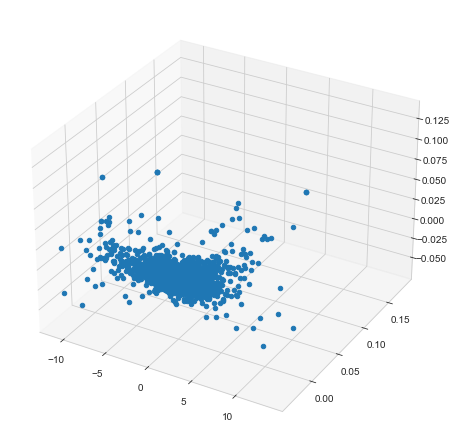

In [48]:
sns.set_style("whitegrid", {'axes.grid' : False})

fig = plt.figure(figsize=(6,6))

ax = Axes3D(fig)

x = x_coord
y = y_coord
z = z_coord


g = ax.scatter(x, y, z, marker='o', depthshade=False, cmap='Paired')

plt.show()

## Color

## Tentative de clustering

In [47]:
from sklearn.cluster import KMeans

In [49]:
pca_result

array([[ 7.14834126e-01, -1.84818273e-04, -1.62251179e-03],
       [ 7.90159102e-01, -8.63411860e-03,  1.42065136e-03],
       [-5.69822521e-01,  4.37312886e-03,  1.82669344e-04],
       ...,
       [ 6.92350946e-01, -3.87649496e-03,  1.55907686e-03],
       [ 6.55417837e-03, -3.98835934e-03,  5.52150341e-03],
       [-1.57269187e+00,  2.68855112e-03,  7.14311988e-05]])

In [55]:
kmeans = KMeans(n_clusters=10, random_state=0).fit(pca_result)

In [56]:
kmeans

KMeans(n_clusters=10, random_state=0)

In [57]:
kmeans.labels_.shape

(2963,)

In [58]:
fig = px.scatter_3d(new_data,x="x", y="y",z="z",color=kmeans.labels_)
fig.show()